# AI Image Search with Multimodal Embeddings

**Author:** Bala Anbalagan  
**Email:** bala.anbalagan@sjsu.edu

---

## Learning Objectives

**Embeddings** are a way to represent the meaning of texts, images, or information as a list of numbers. Using a simple comparison function, we can calculate a similarity score for two embeddings to figure out whether two pieces of information are about similar things.

Common use-cases for embeddings include:
- **Semantic search**: Finding relevant content using natural language
- **Clustering**: Grouping similar items together
- **Classification**: Categorizing content automatically

This notebook demonstrates how to:
1. Generate embeddings for images using Cohere's `embed-v4.0` multimodal model
2. Generate embeddings for text queries
3. Compare them using cosine similarity
4. Build a practical image search engine

---

## Overview

This notebook demonstrates **multimodal embeddings** for AI-powered image search:

**What you'll learn:**
- How embeddings represent images and text as numerical vectors
- Computing similarity between images (finding similar content)
- Searching images with text queries (cross-modal search)

**Workflow:**
1. **Setup**: Load dependencies and configure API keys
2. **Image Loading**: Automatically uses 2 SJSU images (assignment mode) or your own folder (extended mode)
3. **Generate Embeddings**: Create vector representations with Cohere/OpenAI
4. **Image-to-Image Similarity**: Compare images to find similar ones
5. **Image Search**: Search with any text query and get ranked results

---

### Setup and Dependencies

In [1]:
import os
import base64
import glob
import requests
import numpy as np
from dotenv import load_dotenv
from PIL import Image
import cohere
from openai import OpenAI
from IPython.display import display, HTML, Image as IPImage

# Load API keys from .env file
load_dotenv()
COHERE_API_KEY = os.getenv('COHERE_API_KEY')
OPENAI_API_KEY = os.getenv('OPENAI_API_KEY')

# Track available providers
PROVIDERS = {}

if COHERE_API_KEY:
    PROVIDERS['Cohere'] = cohere.ClientV2(api_key=COHERE_API_KEY)
    print("✓ Cohere API key loaded")
else:
    print("⚠️  COHERE_API_KEY not found")

if OPENAI_API_KEY:
    PROVIDERS['OpenAI'] = OpenAI(api_key=OPENAI_API_KEY)
    print("✓ OpenAI API key loaded")
else:
    print("⚠️  OPENAI_API_KEY not found")

if not PROVIDERS:
    print("\n❌ No API keys found! Please add keys to .env file")
    print("Get keys from:")
    print("  - Cohere: https://dashboard.cohere.com/api-keys")
    print("  - OpenAI: https://platform.openai.com/api-keys")
else:
    provider_names = ", ".join(PROVIDERS.keys())
    print(f"\n✓ {len(PROVIDERS)} provider(s) initialized: {provider_names}")

/Users/banbalagan/Projects/ai_image_search/ai_image_search_env/lib/python3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


✓ Cohere API key loaded
✓ OpenAI API key loaded

✓ 2 provider(s) initialized: Cohere, OpenAI


### Helper Functions

In [2]:
def download_image(url):
    """Download image from URL and return binary content."""
    try:
        response = requests.get(url, timeout=10)
        response.raise_for_status()
        return response.content
    except Exception as e:
        print(f"Error downloading {url}: {e}")
        return None

def image_to_base64(image_bytes):
    """Convert image bytes to base64 data URI for API calls."""
    base64_str = base64.b64encode(image_bytes).decode('utf-8')
    return f"data:image/jpeg;base64,{base64_str}"

def load_image_to_base64(image_path):
    """Load image from file and convert to base64 data URI."""
    try:
        with open(image_path, 'rb') as f:
            image_data = f.read()
        base64_str = base64.b64encode(image_data).decode('utf-8')
        return f"data:image/jpeg;base64,{base64_str}"
    except Exception as e:
        print(f"Error loading {image_path}: {e}")
        return None

def cosine_similarity(vec1, vec2):
    """Calculate cosine similarity between two vectors.
    
    Formula: similarity = (A · B) / (||A|| × ||B||)
    
    Returns a value between -1 and 1:
    - 1: Vectors point in the same direction (most similar)
    - 0: Vectors are perpendicular (unrelated)
    - -1: Vectors point in opposite directions (dissimilar)
    """
    vec1 = np.array(vec1)
    vec2 = np.array(vec2)
    dot_product = np.dot(vec1, vec2)
    norm1 = np.linalg.norm(vec1)
    norm2 = np.linalg.norm(vec2)
    return dot_product / (norm1 * norm2)

print("✓ Helper functions loaded")

✓ Helper functions loaded


### ⚙️ Configuration & Image Loading

**EDITABLE:** You can customize the settings below.

The notebook automatically detects how many images you have:
- **2 images**: Uses the 2 SJSU images (assignment mode)
- **3+ images**: Loads all images from the folder (extended mode)


🔍 EXTENDED MODE: Using 10 images from 'images/'
   (Limited to 10 max)

Found 10 images:

  • pexels-bidvine-517980-1249611.jpg (669.9 KB)
  • pexels-cottonbro-4620607.jpg (575.8 KB)
  • pexels-cristian-rojas-8853473.jpg (518.2 KB)
  • pexels-karola-g-7285968.jpg (1686.3 KB)
  • pexels-kindelmedia-8488026.jpg (691.0 KB)
  • pexels-ono-kosuki-5973895.jpg (571.6 KB)
  • pexels-pavel-danilyuk-6461237.jpg (1891.4 KB)
  • pexels-pixabay-7931.jpg (1666.2 KB)
  • pexels-rezwan-1216589.jpg (782.7 KB)
  • pexels-thanh-long-bui-483143920-32913786.jpg (1871.4 KB)

Image Preview (3 per row):




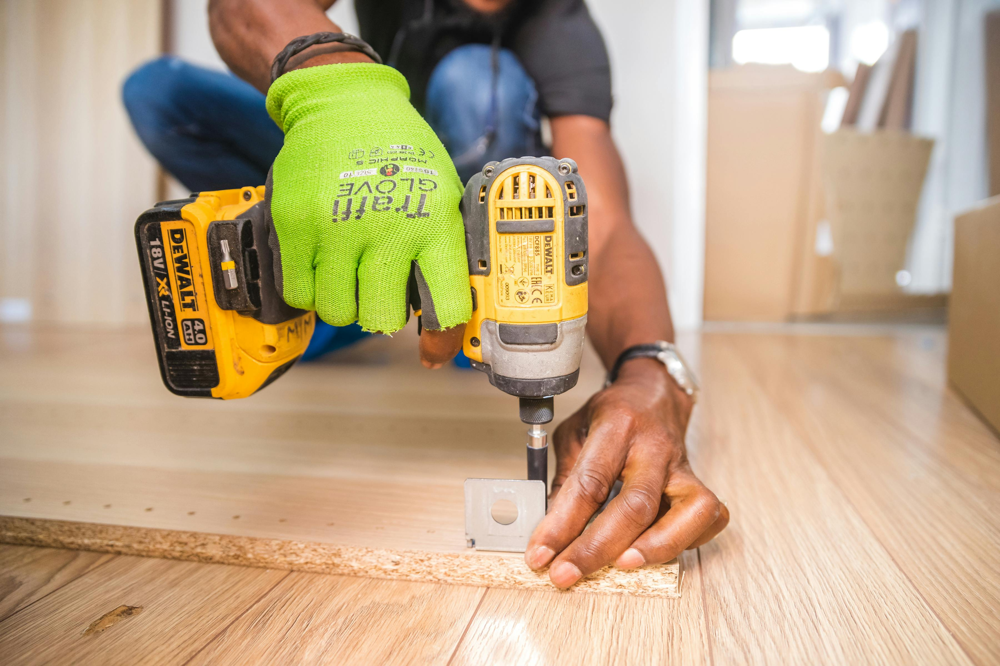
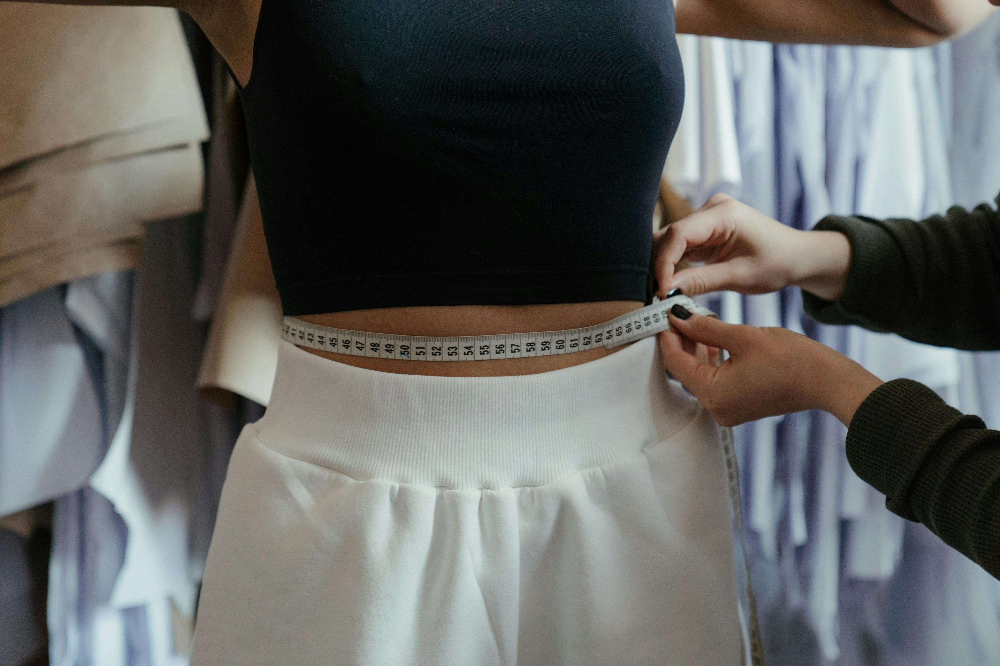
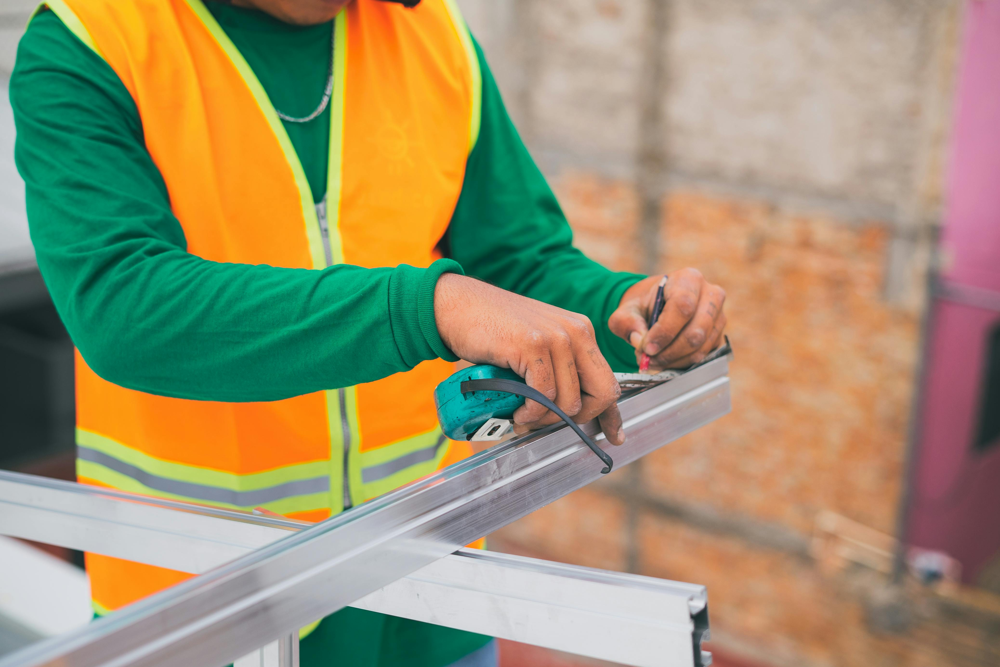


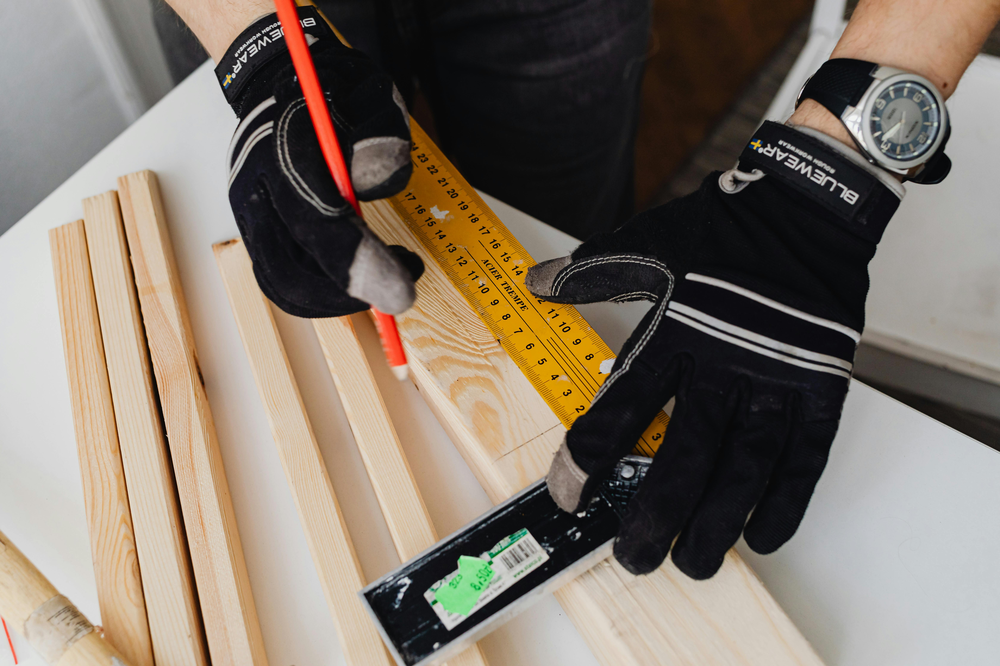
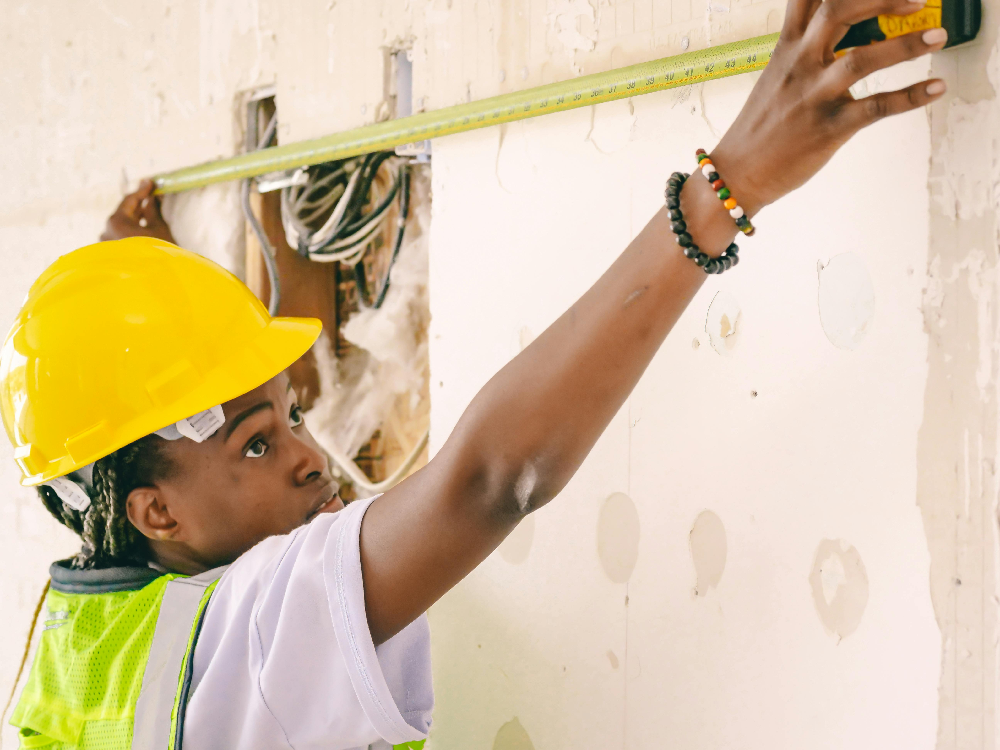
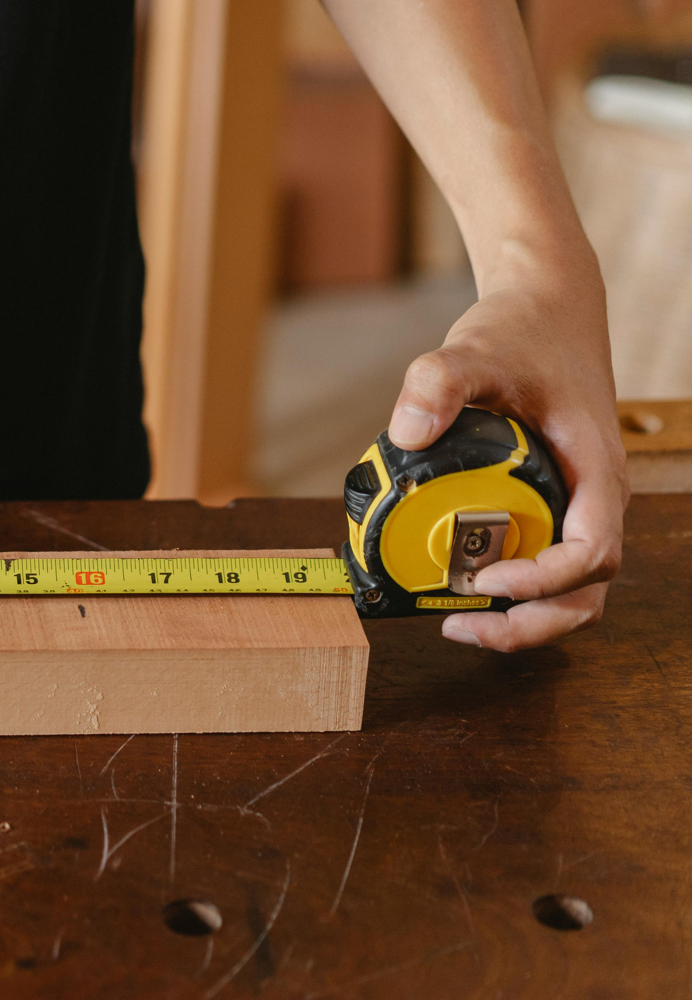


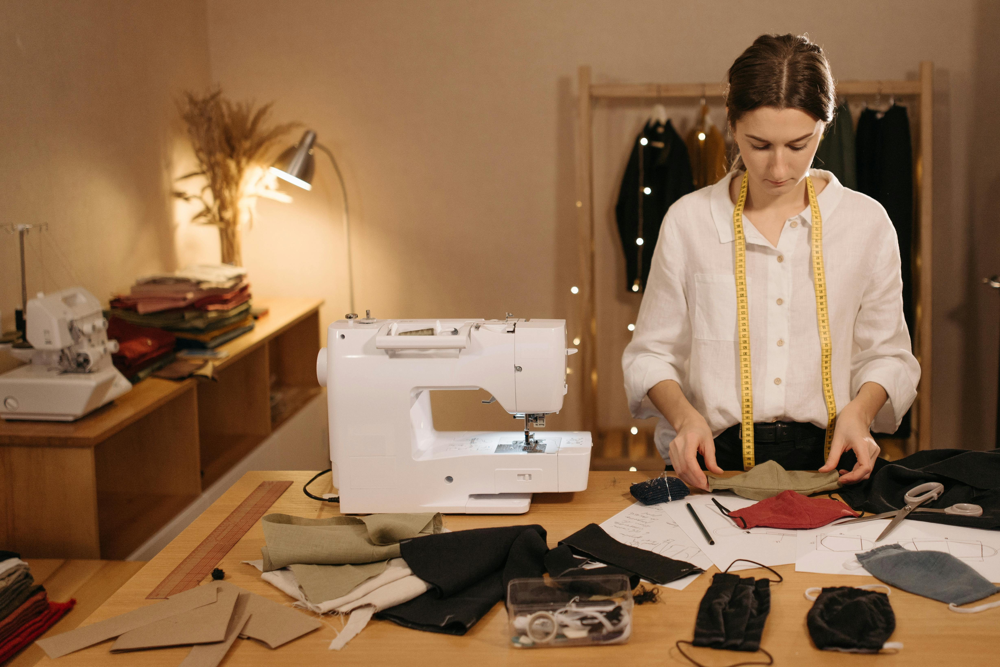
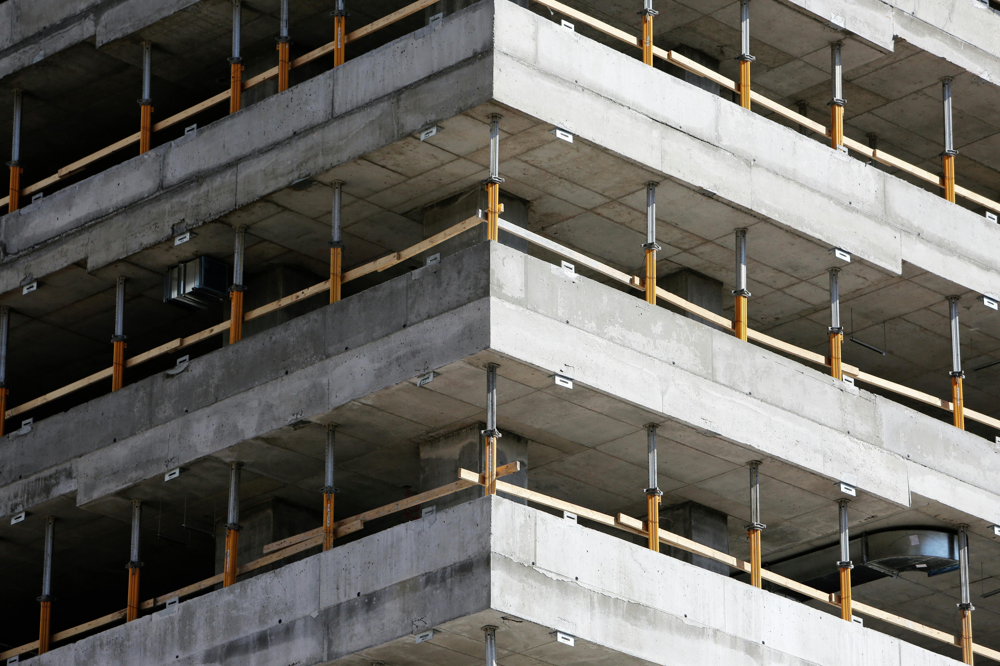
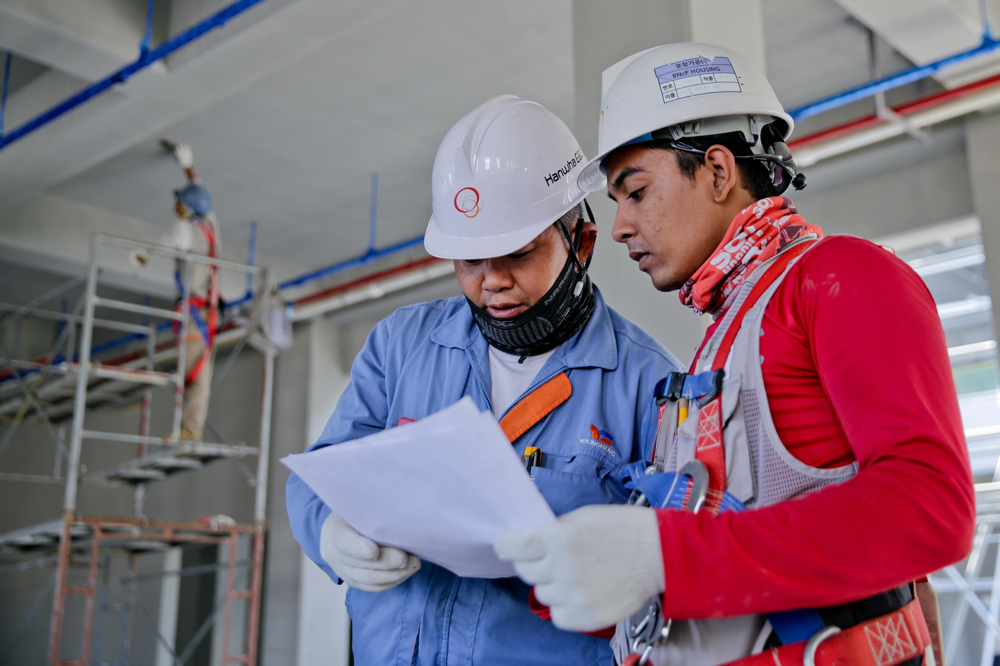


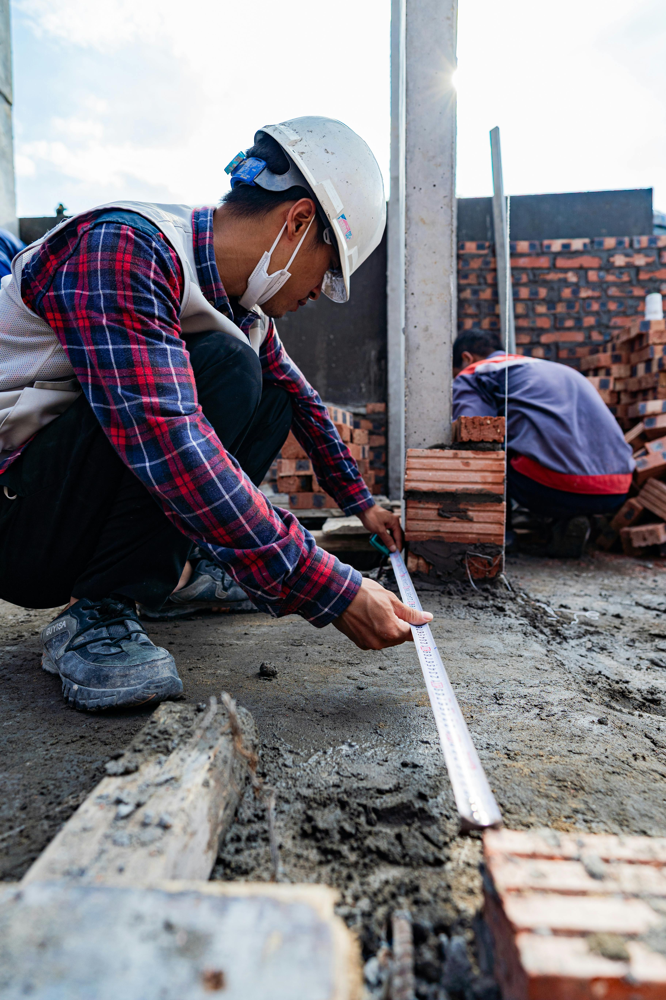

In [3]:
# ============================================================
# CONFIGURATION
# ============================================================

IMAGE_FOLDER = "images"   # Folder containing images
MAX_IMAGES = 10           # Maximum images to load (extended mode)

# ============================================================
# AUTOMATIC IMAGE DETECTION
# ============================================================

# Supported image extensions
SUPPORTED_EXTENSIONS = ['.jpg', '.jpeg', '.png', '.gif', '.bmp']

# Find all images in folder
image_files = []
for ext in SUPPORTED_EXTENSIONS:
    image_files.extend(glob.glob(os.path.join(IMAGE_FOLDER, f"*{ext}")))
    image_files.extend(glob.glob(os.path.join(IMAGE_FOLDER, f"*{ext.upper()}")))

# Remove duplicates and sort
image_files = sorted(list(set(image_files)))

# Decide mode based on image count
if len(image_files) == 2:
    # ============================================================
    # ASSIGNMENT MODE: Use 2 SJSU images
    # ============================================================
    IMAGE_URLS = {
        "Science": "https://www.sjsu.edu/_images/people/ADV_college-of-science_2.jpg",
        "Social Sciences": "https://www.sjsu.edu/_images/people/ADV_college-of-social-sciences_2.jpg"
    }
    
    print("\n" + "="*60)
    print("📚 ASSIGNMENT MODE: Using 2 SJSU images")
    print("="*60 + "\n")
    
    # Display the images
    print("Test Images:\n")
    
    print("1. College of Science")
    display(IPImage(filename='images/science.jpg', width=400))
    
    print("\n2. College of Social Sciences")
    display(IPImage(filename='images/social_sciences.jpg', width=400))
    
    print("\n" + "="*60)

else:
    # ============================================================
    # EXTENDED MODE: Use all images from folder
    # ============================================================
    
    # Limit to MAX_IMAGES
    image_files = image_files[:MAX_IMAGES]
    
    print("\n" + "="*60)
    print(f"🔍 EXTENDED MODE: Using {len(image_files)} images from '{IMAGE_FOLDER}/'")
    print(f"   (Limited to {MAX_IMAGES} max)")
    print("="*60 + "\n")
    
    if len(image_files) == 0:
        print(f"⚠️  No images found in '{IMAGE_FOLDER}/'")
        print("Please add images to the folder.")
    else:
        print(f"Found {len(image_files)} images:\n")
        
        # Convert to IMAGE_URLS format using file paths
        IMAGE_URLS = {}
        for img_path in image_files:
            filename = os.path.basename(img_path)
            name = os.path.splitext(filename)[0].replace('_', ' ').title()
            IMAGE_URLS[name] = img_path
            
            size = os.path.getsize(img_path) / 1024  # KB
            print(f"  • {filename} ({size:.1f} KB)")
        
        print("\n" + "="*60)
        print("Image Preview (3 per row):")
        print("="*60 + "\n")
        
        # Display preview in grid (3 per row)
        image_list = list(IMAGE_URLS.items())
        for row_start in range(0, len(image_list), 3):
            row_images = image_list[row_start:row_start + 3]
            
            # Build HTML for this row
            row_html = '<div style="display: flex; gap: 15px; margin-bottom: 20px; flex-wrap: wrap;">'
            
            for name, img_path in row_images:
                try:
                    # Load and encode image
                    with open(img_path, 'rb') as f:
                        img_data = base64.b64encode(f.read()).decode()
                    
                    # Create image card
                    row_html += f"""
                    <div style="flex: 1; min-width: 200px; max-width: 300px; text-align: center;">
                        <img src="data:image/jpeg;base64,{img_data}" 
                             style="width: 100%; max-height: 200px; object-fit: cover; 
                                    border: 2px solid #2c5aa0; border-radius: 5px;">
                        <p style="font-weight: bold; color: #2c5aa0; margin-top: 8px; font-size: 14px;">
                            {name[:25]}
                        </p>
                    </div>
                    """
                except Exception as e:
                    row_html += f"""
                    <div style="flex: 1; min-width: 200px; max-width: 300px; text-align: center;">
                        <div style="border: 2px solid #ccc; border-radius: 5px; padding: 20px; color: #999;">
                            Error loading<br>{name[:20]}
                        </div>
                    </div>
                    """
            
            row_html += '</div>'
            display(HTML(row_html))
        
        print("\n" + "="*60)

### Generate Image Embeddings

Now let's generate embeddings for these images using Cohere's `embed-v4.0` model.

**What's happening here:**
- The model converts each image into a 1,536-dimensional vector
- Each dimension captures different aspects of the image (objects, colors, composition, etc.)
- These vectors represent the "meaning" of the images in numerical form

In [4]:
print("Generating image embeddings...\n")

# Store embeddings by provider
all_embeddings = {provider: {} for provider in PROVIDERS.keys()}

for name, source in IMAGE_URLS.items():
    print(f"Processing {name}...")
    
    # Determine if source is URL or file path
    is_url = source.startswith('http://') or source.startswith('https://')
    
    if is_url:
        # Check if we have a local cached copy first
        cached_path = None
        if name == "Science":
            cached_path = "images/science.jpg"
        elif name == "Social Sciences":
            cached_path = "images/social_sciences.jpg"
        
        # Use cached file if available, otherwise download
        if cached_path and os.path.exists(cached_path):
            try:
                with open(cached_path, 'rb') as f:
                    img_bytes = f.read()
                print(f"  📁 Using cached file: {cached_path}")
            except Exception as e:
                print(f"  ⚠️  Cache read failed, downloading... {e}")
                img_bytes = download_image(source)
        else:
            img_bytes = download_image(source)
            if img_bytes:
                print(f"  🌐 Downloaded from URL")
        
        if img_bytes is None:
            print("  ❌ Failed to get image\n")
            continue
    else:
        # Load from local file
        try:
            with open(source, 'rb') as f:
                img_bytes = f.read()
            print(f"  📁 Loaded from file")
        except Exception as e:
            print(f"  ❌ Failed to load: {e}\n")
            continue
    
    # Generate embeddings with each available provider
    for provider_name, client in PROVIDERS.items():
        try:
            if provider_name == "Cohere":
                # Cohere: Native image support
                base64_img = image_to_base64(img_bytes)
                response = client.embed(
                    model="embed-v4.0",
                    input_type="image",
                    embedding_types=["float"],
                    images=[base64_img]
                )
                all_embeddings[provider_name][name] = response.embeddings.float[0]
                print(f"  ✓ {provider_name}: {len(response.embeddings.float[0])}-dim")
                
            elif provider_name == "OpenAI":
                # OpenAI: Skip image embeddings (text-only model can't see images)
                print(f"  ⊘ {provider_name}: Skipped (text-only model, cannot process images)")
                
        except Exception as e:
            print(f"  ❌ {provider_name}: {str(e)[:60]}")
    
    print()

print(f"{'='*60}")
for provider, embeddings in all_embeddings.items():
    if len(embeddings) > 0:
        print(f"✓ {provider}: {len(embeddings)} image embeddings")
    else:
        print(f"⊘ {provider}: Skipped (not suitable for images)")
print(f"{'='*60}")

Generating image embeddings...

Processing Pexels-Bidvine-517980-1249611...
  📁 Loaded from file
  ✓ Cohere: 1536-dim
  ⊘ OpenAI: Skipped (text-only model, cannot process images)

Processing Pexels-Cottonbro-4620607...
  📁 Loaded from file
  ✓ Cohere: 1536-dim
  ⊘ OpenAI: Skipped (text-only model, cannot process images)

Processing Pexels-Cristian-Rojas-8853473...
  📁 Loaded from file
  ✓ Cohere: 1536-dim
  ⊘ OpenAI: Skipped (text-only model, cannot process images)

Processing Pexels-Karola-G-7285968...
  📁 Loaded from file
  ✓ Cohere: 1536-dim
  ⊘ OpenAI: Skipped (text-only model, cannot process images)

Processing Pexels-Kindelmedia-8488026...
  📁 Loaded from file
  ✓ Cohere: 1536-dim
  ⊘ OpenAI: Skipped (text-only model, cannot process images)

Processing Pexels-Ono-Kosuki-5973895...
  📁 Loaded from file
  ✓ Cohere: 1536-dim
  ⊘ OpenAI: Skipped (text-only model, cannot process images)

Processing Pexels-Pavel-Danilyuk-6461237...
  📁 Loaded from file
  ✓ Cohere: 1536-dim
  ⊘ OpenAI: 

### Compute Image-to-Image Similarity

Let's measure how similar the two images are to each other using cosine similarity.


IMAGE-TO-IMAGE SIMILARITY

Finding most similar image pairs from 10 images...

Cohere:
------------------------------------------------------------
Top 5 most similar pairs:




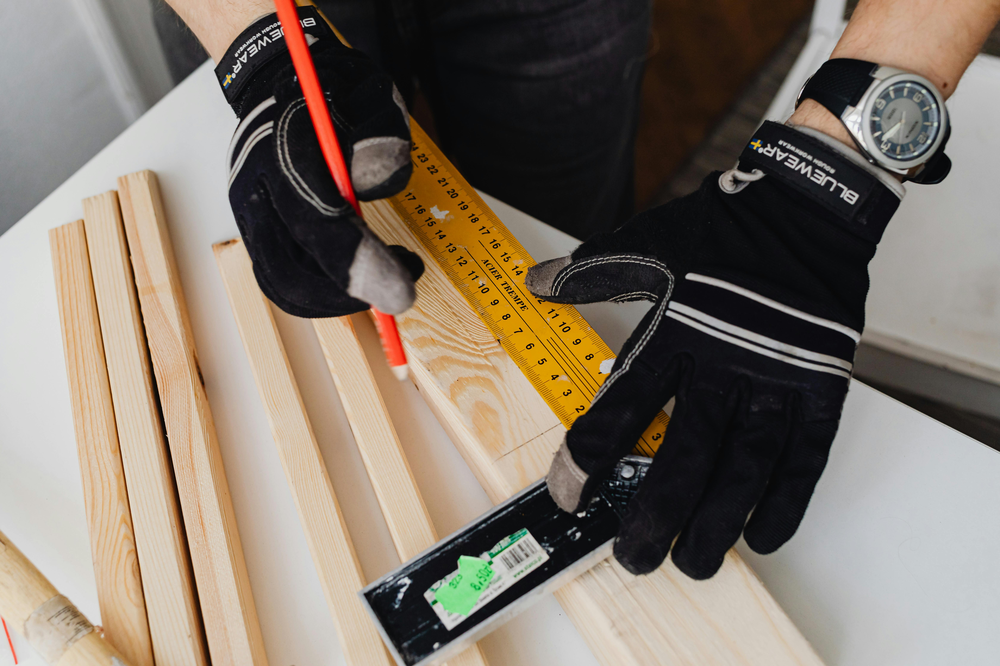
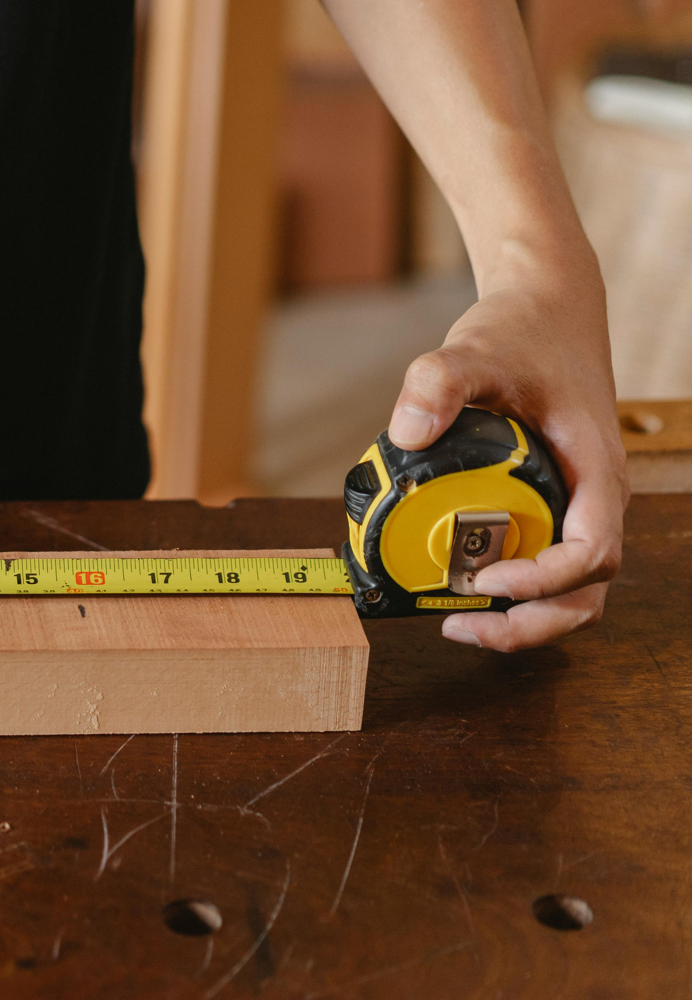


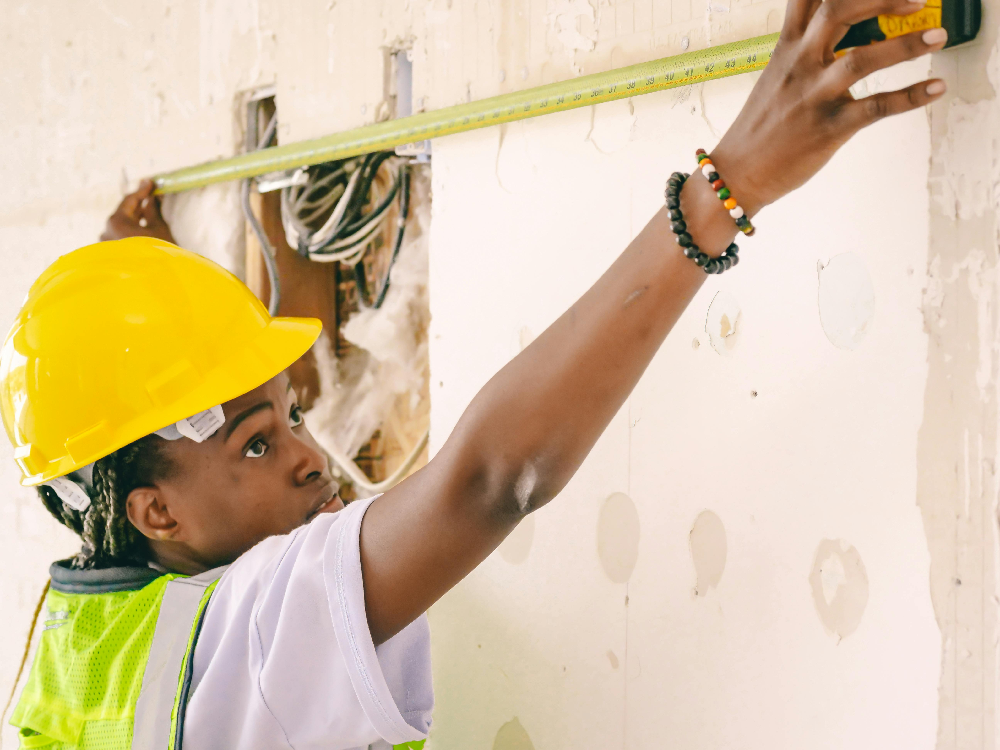
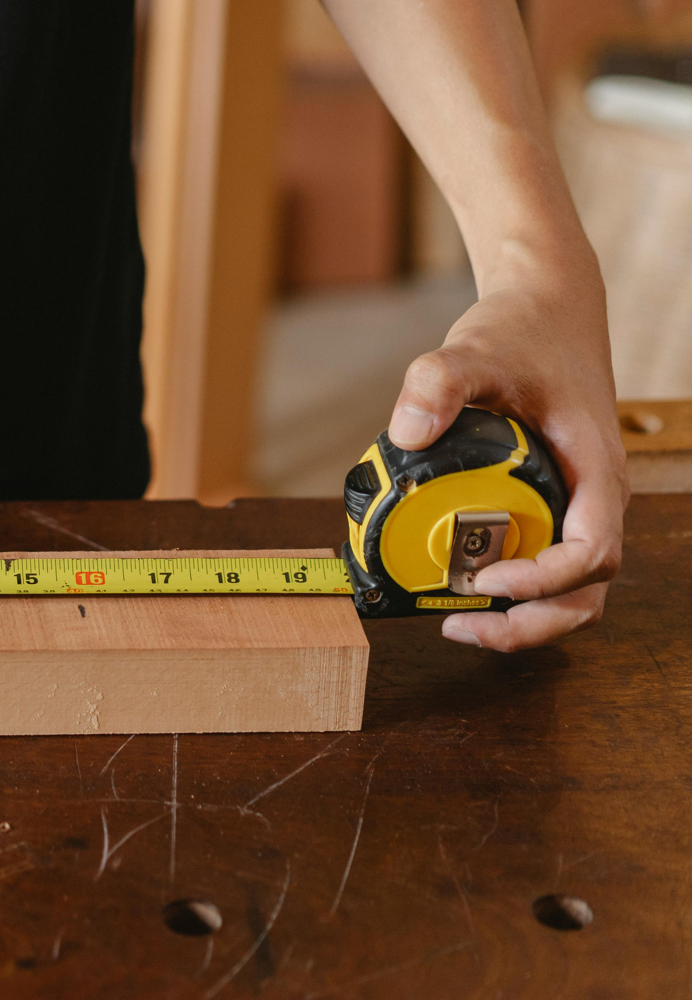


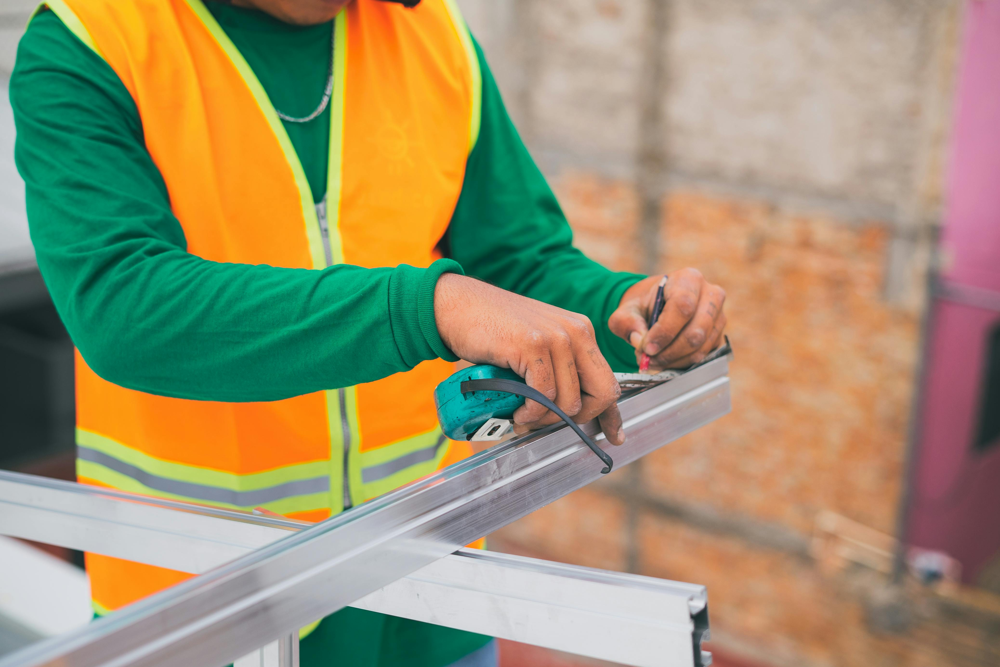
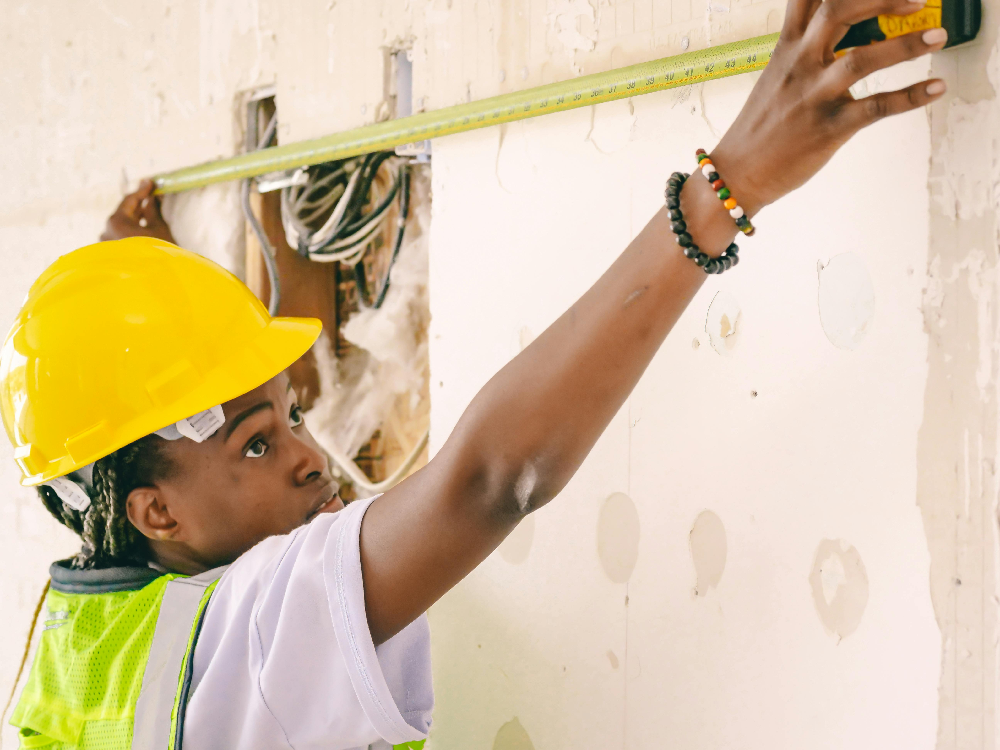


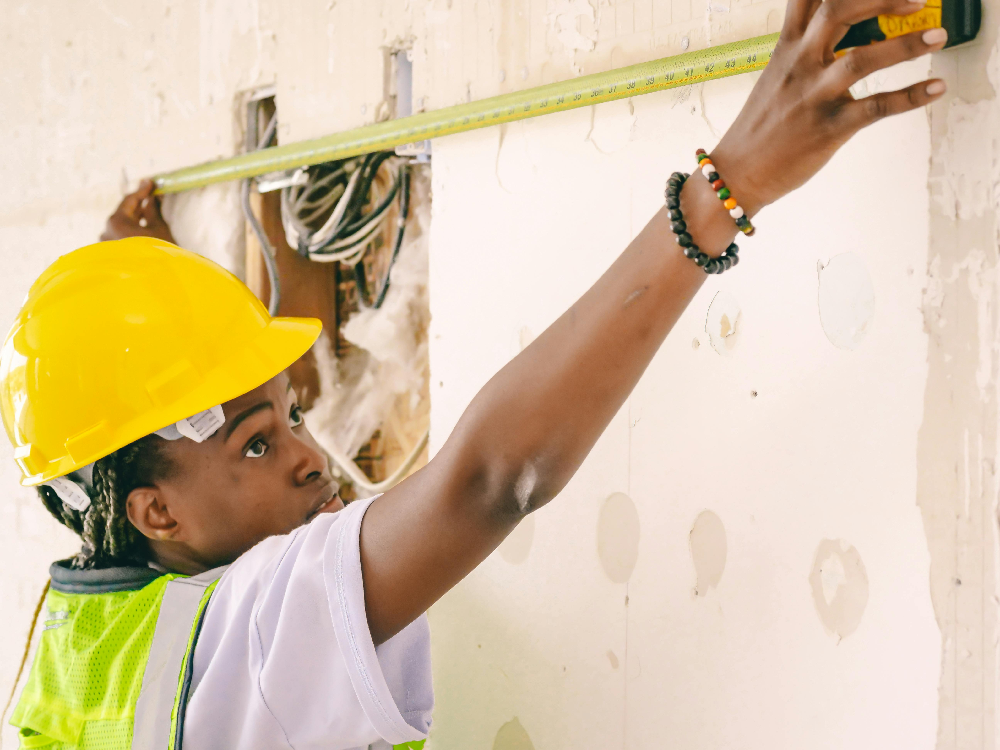
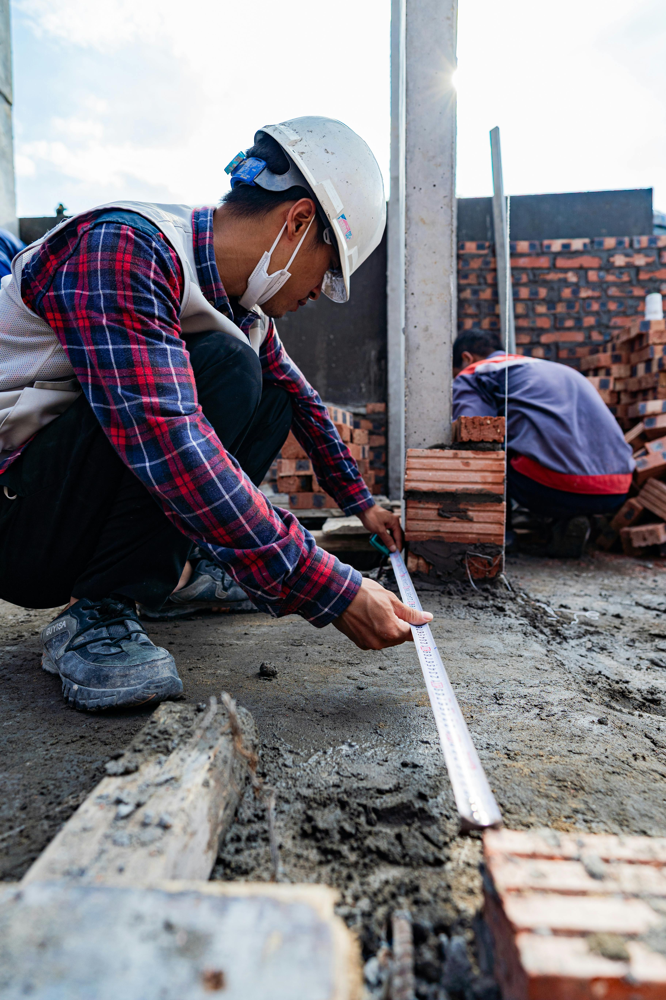


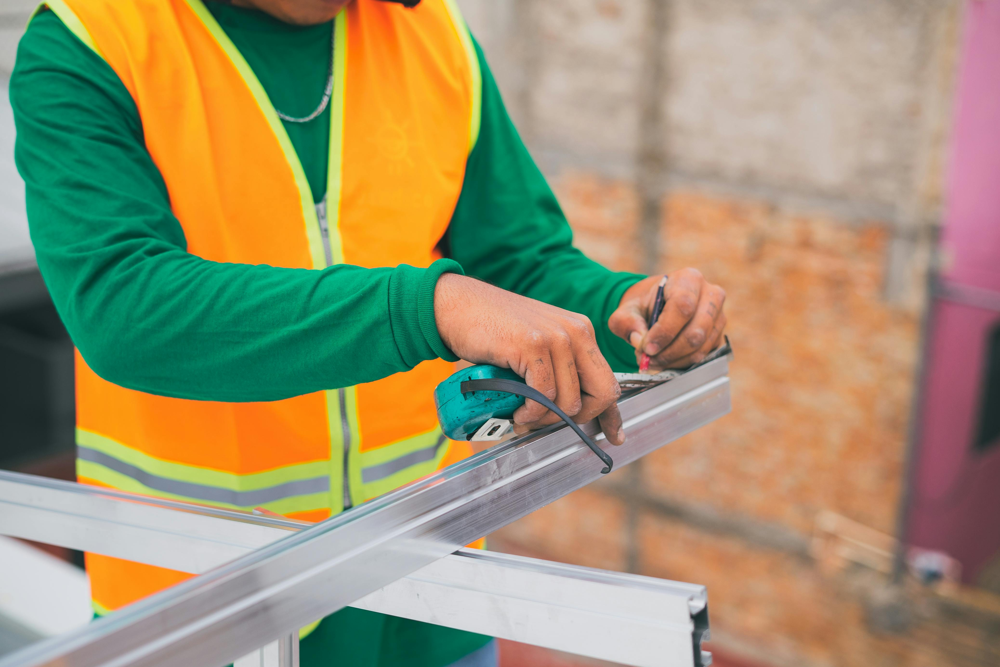
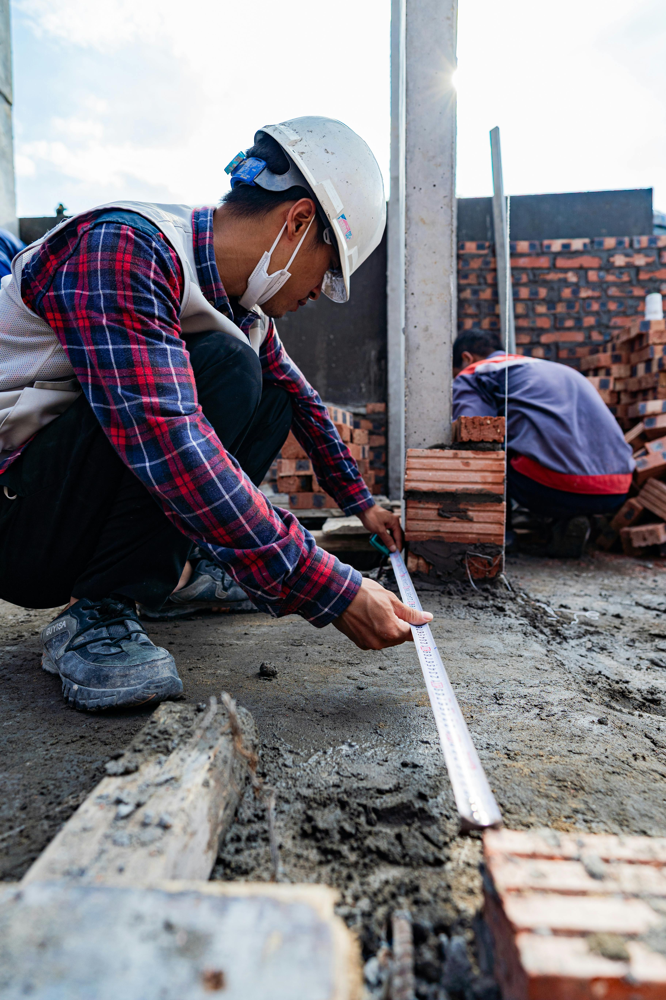

In [5]:
print("\n" + "="*60)
print("IMAGE-TO-IMAGE SIMILARITY")
print("="*60)

image_names = list(IMAGE_URLS.keys())

if len(image_names) == 2:
    # Assignment mode: Show the 2 images side-by-side
    print("\nComparing: Science vs Social Sciences\n")
    
    for provider, embeddings in all_embeddings.items():
        if len(embeddings) >= 2 and "Science" in embeddings and "Social Sciences" in embeddings:
            similarity = cosine_similarity(
                embeddings["Science"],
                embeddings["Social Sciences"]
            )
            print(f"{provider:<15} {similarity:.6f}")
            
            # Display images side-by-side
            html = f"""
            <div style="display: flex; gap: 20px; margin: 20px 0; align-items: center;">
                <div style="text-align: center;">
                    <img src="images/science.jpg" style="max-width: 300px; border: 2px solid #2c5aa0; border-radius: 5px;">
                    <p style="font-weight: bold; color: #2c5aa0;">Science</p>
                </div>
                <div style="font-size: 24px; color: #666;">↔</div>
                <div style="text-align: center;">
                    <img src="images/social_sciences.jpg" style="max-width: 300px; border: 2px solid #2c5aa0; border-radius: 5px;">
                    <p style="font-weight: bold; color: #2c5aa0;">Social Sciences</p>
                </div>
            </div>
            """
            display(HTML(html))
else:
    # Extended mode: Show top 5 most similar pairs with images
    print(f"\nFinding most similar image pairs from {len(image_names)} images...\n")
    
    for provider, embeddings in all_embeddings.items():
        if len(embeddings) >= 2:
            print(f"{provider}:")
            print("-" * 60)
            
            # Compute all pairwise similarities
            similarities_with_images = []
            for i in range(len(image_names)):
                for j in range(i + 1, len(image_names)):
                    img1, img2 = image_names[i], image_names[j]
                    if img1 in embeddings and img2 in embeddings:
                        similarity = cosine_similarity(
                            embeddings[img1],
                            embeddings[img2]
                        )
                        similarities_with_images.append((img1, img2, similarity))
            
            # Sort by similarity (highest first)
            similarities_with_images.sort(key=lambda x: x[2], reverse=True)
            
            # Show top 5 pairs
            top_n = min(5, len(similarities_with_images))
            print(f"Top {top_n} most similar pairs:\n")
            
            for rank, (img1, img2, score) in enumerate(similarities_with_images[:top_n], 1):
                # Get image paths
                img1_path = IMAGE_URLS[img1]
                img2_path = IMAGE_URLS[img2]
                
                # Load and encode images
                try:
                    with open(img1_path, 'rb') as f:
                        img1_data = base64.b64encode(f.read()).decode()
                    with open(img2_path, 'rb') as f:
                        img2_data = base64.b64encode(f.read()).decode()
                    
                    # Create side-by-side display
                    html = f"""
                    <div style="margin: 30px 0; padding: 20px; background: #f0f7ff; border-radius: 10px; border: 2px solid #2c5aa0;">
                        <h3 style="color: #2c5aa0; margin-top: 0;">#{rank} - Similarity: {score:.4f}</h3>
                        <div style="display: flex; gap: 20px; align-items: center; justify-content: center;">
                            <div style="text-align: center; flex: 1;">
                                <img src="data:image/jpeg;base64,{img1_data}" style="max-width: 100%; max-height: 250px; border: 2px solid #2c5aa0; border-radius: 5px;">
                                <p style="font-weight: bold; color: #2c5aa0; margin-top: 10px;">{img1[:30]}</p>
                            </div>
                            <div style="font-size: 32px; color: #2c5aa0; font-weight: bold;">↔</div>
                            <div style="text-align: center; flex: 1;">
                                <img src="data:image/jpeg;base64,{img2_data}" style="max-width: 100%; max-height: 250px; border: 2px solid #2c5aa0; border-radius: 5px;">
                                <p style="font-weight: bold; color: #2c5aa0; margin-top: 10px;">{img2[:30]}</p>
                            </div>
                        </div>
                        <p style="margin-bottom: 0; color: #666; text-align: center; margin-top: 15px;">
                            These images share similar visual features according to the embedding model.
                        </p>
                    </div>
                    """
                    display(HTML(html))
                except Exception as e:
                    print(f"  Error displaying pair: {img1} ↔ {img2}")
            
            print()

print("="*60)

---

## Image Search

Search your images using **any text query** and get ranked results!

This demonstrates the core capability: comparing text embeddings with image embeddings to find the best matches. The embeddings are already generated, so searching is instant.

### Search Function Setup

### Define Search Function

In [6]:
# Use Cohere for interactive search
cohere_client = PROVIDERS.get('Cohere')

if cohere_client:
    print(f"✓ Using Cohere for interactive search")
    print(f"✓ {len(all_embeddings.get('Cohere', {}))} images ready to search")
else:
    print("❌ Cohere API key required for image search")

def search_images(query, top_k=5):
    """Search images with a text query and display ranked results."""
    if not cohere_client:
        print("❌ Cohere API key required")
        return
        
    print(f"\n{'='*60}")
    print(f"Searching for: '{query}'")
    print(f"{'='*60}\n")
    
    # Generate query embedding
    response = cohere_client.embed(
        model="embed-v4.0",
        input_type="search_query",
        embedding_types=["float"],
        texts=[query]
    )
    query_embedding = response.embeddings.float[0]
    
    # Get Cohere image embeddings
    image_embeddings = all_embeddings.get('Cohere', {})
    
    # Compute similarities
    similarities = []
    for img_name, img_embedding in image_embeddings.items():
        similarity = cosine_similarity(query_embedding, img_embedding)
        similarities.append((img_name, similarity))
    
    # Sort by similarity (highest first)
    similarities.sort(key=lambda x: x[1], reverse=True)
    
    # Display results in grid format (3 per row)
    results_to_show = similarities[:top_k]
    print(f"Top {len(results_to_show)} Results:\n")
    
    # Group results into rows of 3
    for row_start in range(0, len(results_to_show), 3):
        row_results = results_to_show[row_start:row_start + 3]
        
        # Build HTML for this row
        row_html = '<div style="display: flex; gap: 20px; margin-bottom: 30px; flex-wrap: wrap;">'
        
        for img_name, score in row_results:
            rank = row_start + row_results.index((img_name, score)) + 1
            
            # Get image source
            img_source = IMAGE_URLS[img_name]
            
            # Convert image to base64 for inline display
            try:
                with open(img_source, 'rb') as f:
                    img_data = base64.b64encode(f.read()).decode()
                img_base64 = f"data:image/jpeg;base64,{img_data}"
                
                # Create card with embedded image
                row_html += f"""
                <div style="flex: 1; min-width: 250px; max-width: 350px; 
                            border: 2px solid #2c5aa0; border-radius: 10px; 
                            padding: 15px; background: #f0f7ff;">
                    <div style="font-weight: bold; color: #2c5aa0; font-size: 18px; margin-bottom: 10px;">
                        #{rank} - {img_name[:30]}
                    </div>
                    <div style="font-size: 16px; color: #333; margin-bottom: 10px;">
                        Score: <strong>{score:.4f}</strong>
                    </div>
                    <img src="{img_base64}" style="width: 100%; height: auto; border-radius: 5px;">
                </div>
                """
            except Exception as e:
                # Fallback if image can't be loaded
                row_html += f"""
                <div style="flex: 1; min-width: 250px; max-width: 350px; 
                            border: 2px solid #2c5aa0; border-radius: 10px; 
                            padding: 15px; background: #f0f7ff;">
                    <div style="font-weight: bold; color: #2c5aa0; font-size: 18px;">
                        #{rank} - {img_name}
                    </div>
                    <div style="font-size: 16px; color: #333;">
                        Score: <strong>{score:.4f}</strong>
                    </div>
                    <div style="color: red; margin-top: 10px;">Error loading image</div>
                </div>
                """
        
        row_html += '</div>'
        display(HTML(row_html))

print("✓ Search function ready")
print("\nTry searching:")
print("  search_images('person with tape and cap', top_k=3)")
print("  search_images('your custom query', top_k=6)")

✓ Using Cohere for interactive search
✓ 10 images ready to search
✓ Search function ready

Try searching:
  search_images('person with tape and cap', top_k=3)
  search_images('your custom query', top_k=6)



Searching for: 'person with tape and cap'

Top 3 Results:




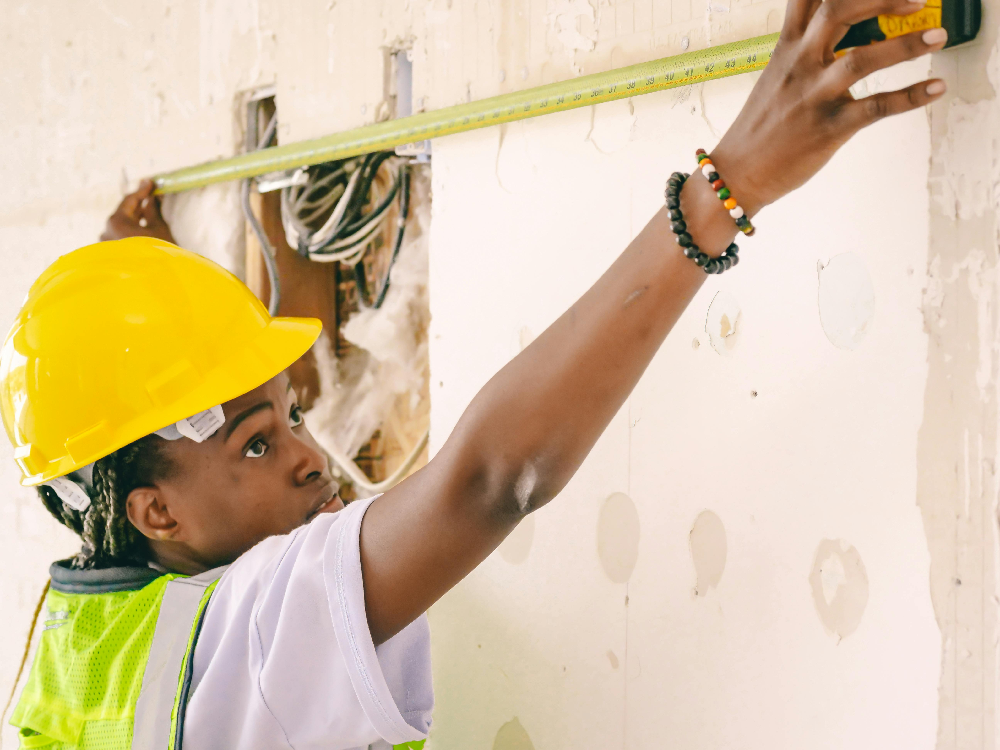
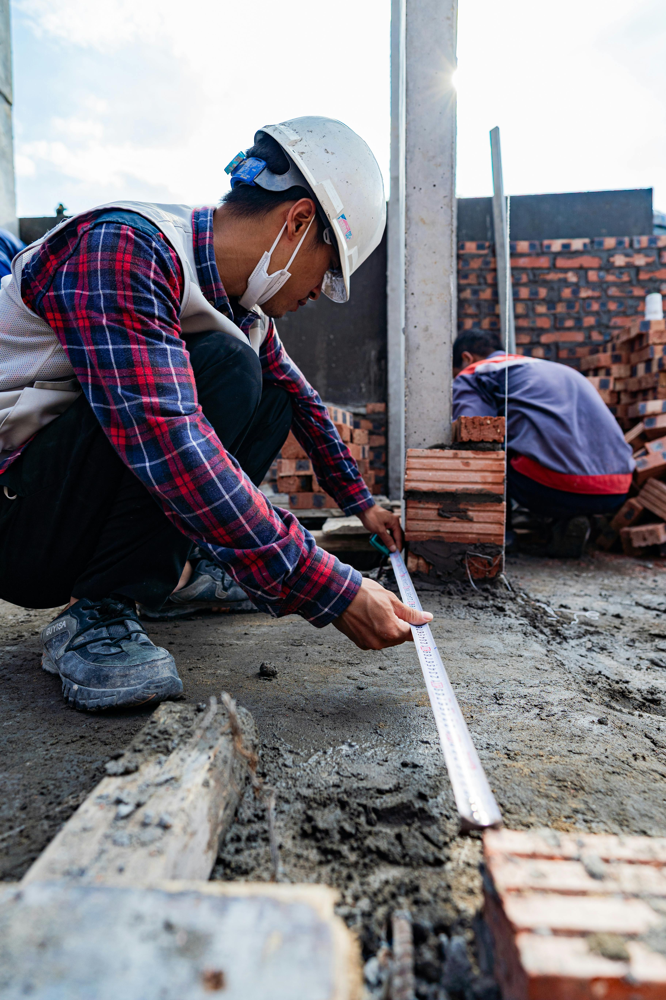
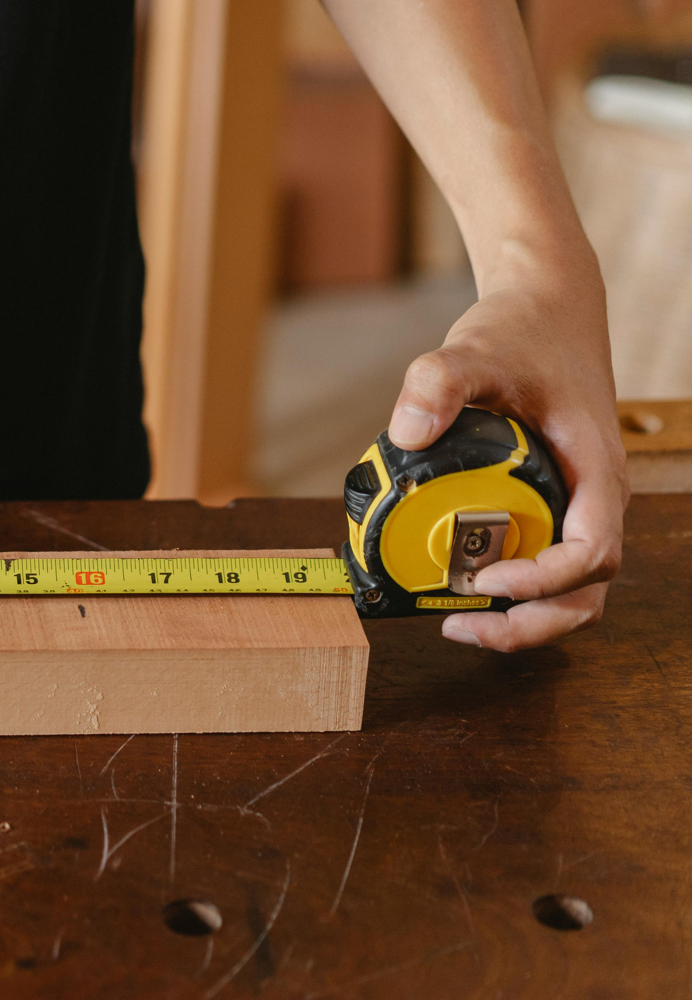

In [7]:
# ⚙️ EDITABLE: Search with your query
search_images("person with tape and cap", top_k=3)

# Try other queries:
# search_images("cart with single tire", top_k=3)
# search_images("person sitting", top_k=5)
# search_images("outdoor scene", top_k=3)
# search_images("technology", top_k=5)

---

Each image and text query is converted to a high-dimensional vector (1,536 dimensions for Cohere, 3,072 for OpenAI). Similar concepts are placed close together in this space. Cosine similarity measures the angle between vectors - a smaller angle means more similar content. Multimodal models like Cohere's `embed-v4.0` embed both images and text into the same space, enabling cross-modal search.

The similarity scores range from -1 to 1, where higher scores indicate stronger matches. Scores above 0.8 show excellent matches, 0.6-0.8 are good matches, 0.4-0.6 are moderate, 0.2-0.4 are weak, and below 0.2 are poor matches.

Cohere's `embed-v4.0` is a multimodal model trained on millions of image-text pairs. It learned to recognize objects, scenes, people, and actions, understand relationships between visual and textual concepts, and map both modalities into a unified semantic space. This enables finding images using natural language.

When comparing providers, Cohere has native image support and can actually "see" the image content, while OpenAI's text-only model uses URLs or filenames as a proxy, which is less accurate for visual search.

Embeddings enable many practical applications beyond search - clustering similar content, automatic classification, content recommendation, duplicate detection, and content moderation all use the same underlying technology.

---

**Image Attribution:** Sample images provided by talented photographers on [Pexels.com](https://www.pexels.com). All images are free to use under the Pexels License.

---

---

Embeddings represent meaning as numbers, enabling mathematical comparisons between different types of content. Cosine similarity provides a simple way to measure relevance - the higher the score, the more similar the concepts. Multimodal models bridge the gap between text and images by placing them in the same semantic space, making cross-modal search possible.

These techniques have practical applications everywhere - search engines, content recommendation systems, automated classification, image clustering, duplicate detection, and content moderation all rely on embeddings to understand and compare content at scale.

Try experimenting with different query phrasings to see what works best. You can add more images to your folder and re-run the notebook to see how well it scales. For production applications, consider building a web interface with Streamlit or Gradio, or scale to thousands of images using vector databases like Pinecone or Weaviate.

**Resources:**
- [Cohere Embed v4.0 Documentation](https://docs.cohere.com/docs/embed-v4)
- [Image Embeddings Guide](https://docs.cohere.com/v2/docs/embeddings#image-embeddings)
- [Get Free API Key](https://dashboard.cohere.com/api-keys)
- [Vector Search Tutorial](https://docs.cohere.com/docs/semantic-search)